## Gender Equity Analysis in College Athletics <br>

### Loading the Schools.csv dataset

In [ ]:
file_location = "/FileStore/tables/Schools-1.csv"
file_type = "csv"

infer_schema = "true"
first_row_is_header = "true"
delimiter = ","

df = spark.read.format(file_type) \
  .option("inferSchema", infer_schema) \
  .option("header", first_row_is_header) \
  .option("sep", delimiter) \
  .load(file_location)

### Importing Necessary Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pyspark.sql import SparkSession
from pyspark.sql.functions import col, sum as pyspark_sum
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import LinearRegression
from pyspark.ml.evaluation import RegressionEvaluator
from pyspark.ml import Pipeline
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
from pyspark.ml.regression import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

### Creating a dataframe for exploratory analysis, visualization and descriptive statistics

In [ ]:
data = df[['institution_name','state_cd','EFMaleCount','EFFemaleCount','EFTotalCount','sector_name','PARTIC_MEN','PARTIC_WOMEN','PARTIC_COED_MEN','PARTIC_COED_WOMEN','REV_MEN','REV_WOMEN','TOTAL_REV_MENWOMEN','EXP_MEN','EXP_WOMEN','TOTAL_EXP_MENWOMEN', 'MEN_TOTAL_ASSTCOACH', 'WOMEN_TOTAL_ASTCOACH', 'COED_TOTAL_ASTCOACH','MEN_TOTAL_HEADCOACH', 'WOMEN_TOTAL_HDCOACH', 'COED_TOTAL_HDCOACH','TOTAL_OPEXP_MENWOMEN','TOTAL_OPEXP_COEDTEAM','TOTAL_OPEXP_INCLCOED','TOTAL_REV_COED','TOTAL_REVENUE_ALL','TOTAL_EXP_COED','TOTAL_EXPENSE_ALL','Sports']]

### Displaying the dataframe

In [ ]:
data.display()

institution_name,state_cd,EFMaleCount,EFFemaleCount,EFTotalCount,sector_name,PARTIC_MEN,PARTIC_WOMEN,PARTIC_COED_MEN,PARTIC_COED_WOMEN,REV_MEN,REV_WOMEN,TOTAL_REV_MENWOMEN,EXP_MEN,EXP_WOMEN,TOTAL_EXP_MENWOMEN,MEN_TOTAL_ASSTCOACH,WOMEN_TOTAL_ASTCOACH,COED_TOTAL_ASTCOACH,MEN_TOTAL_HEADCOACH,WOMEN_TOTAL_HDCOACH,COED_TOTAL_HDCOACH,TOTAL_OPEXP_MENWOMEN,TOTAL_OPEXP_COEDTEAM,TOTAL_OPEXP_INCLCOED,TOTAL_REV_COED,TOTAL_REVENUE_ALL,TOTAL_EXP_COED,TOTAL_EXPENSE_ALL,Sports
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",37,null,null,null,275210,null,275210,297153,null,297153,1,null,null,1,null,null,124310,null,124310,null,275210,null,297153,Baseball
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",14,17,null,null,1450494,1258462,2708956,1132578,1067456,2200034,2,2,null,1,1,null,802155,null,802155,null,2708956,null,2200034,Basketball
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",96,null,null,null,4119664,null,4119664,3437529,null,3437529,10,null,null,1,null,null,1124376,null,1124376,null,4119664,null,3437529,Football
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",7,null,null,null,64347,null,64347,59524,null,59524,0,null,null,1,null,null,20325,null,20325,null,64347,null,59524,Golf
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",null,31,null,null,null,494874,494874,null,355614,355614,null,0,null,null,1,null,57843,null,57843,null,494874,null,355614,Soccer
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",null,24,null,null,null,292408,292408,null,379150,379150,null,1,null,null,1,null,29765,null,29765,null,292408,null,379150,Softball
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",9,8,null,null,103652,144623,248275,151865,194398,346263,0,0,null,1,1,null,23240,null,23240,null,248275,null,346263,Tennis
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",18,19,null,null,68974,278436,347410,94724,227855,322579,0,1,null,1,1,null,55435,null,55435,null,347410,null,322579,Track and Field (Indoor)
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",18,19,null,null,68734,197810,266544,97648,211987,309635,0,0,null,1,1,null,51184,null,51184,null,266544,null,309635,Track and Field (Outdoor)
Alabama A & M University,AL,1823,2706,4529,"Public, 4-year or above",null,6,null,null,null,22465,22465,null,73125,73125,null,0,null,null,1,null,49575,null,49575,null,22465,null,73125,Cross Country


### Cleaning the dataset

In [ ]:
data = data.drop_duplicates()
data = data.fillna(0)
data = data.dropna()
data.describe().display()

summary,institution_name,state_cd,EFMaleCount,EFFemaleCount,EFTotalCount,sector_name,PARTIC_MEN,PARTIC_WOMEN,PARTIC_COED_MEN,PARTIC_COED_WOMEN,REV_MEN,REV_WOMEN,TOTAL_REV_MENWOMEN,EXP_MEN,EXP_WOMEN,TOTAL_EXP_MENWOMEN,MEN_TOTAL_ASSTCOACH,WOMEN_TOTAL_ASTCOACH,COED_TOTAL_ASTCOACH,MEN_TOTAL_HEADCOACH,WOMEN_TOTAL_HDCOACH,COED_TOTAL_HDCOACH,TOTAL_OPEXP_MENWOMEN,TOTAL_OPEXP_COEDTEAM,TOTAL_OPEXP_INCLCOED,TOTAL_REV_COED,TOTAL_REVENUE_ALL,TOTAL_EXP_COED,TOTAL_EXPENSE_ALL,Sports
count,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635
mean,null,null,2077.6874964559115,2567.6837538984973,4645.371250354408,null,23.184065778281827,17.106606180890275,0.23963708534165012,0.1967110859087043,673488.1612134959,266348.0554578962,939836.2166713921,558543.6151970513,300745.90286362346,859289.5180606748,1.778338531329742,1.4166713921179472,0.014573291749362064,0.7195350155939892,0.8064644173518571,0.0188829033172668,165748.65812305076,573.5843493053586,166322.2424723561,3063.639693790757,942899.8563651829,2890.924695208392,862180.4427558832,null
stddev,null,null,3272.8650639844013,3690.1809414121612,6897.282021682857,null,30.615146613024585,19.673891720915154,2.738740067551665,2.2938864417275027,4835204.861587076,476134.2726003895,4896576.131178554,2878743.52237239,576683.8872550095,3035811.6663671713,2.4917525899773985,1.550486769189334,0.19998506579441597,0.559229741089505,0.5155219727743646,0.17117835664332484,517744.7074907316,7317.725949569292,517628.9664584985,42187.78306990731,4896215.492427425,33515.93355678501,3035252.3152610096,null
min,Abilene Christian University,AK,1,4,62,"Private for-profit, 4-year or above",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1063,Archery
max,Yuba College,WY,34767,29793,64560,"Public, 4-year or above",496,283,105,91,161532860,9537698,161532860,75005971,9537698,75005971,43,34,7,20,20,4,16056641,286050,16056641,3254174,161532860,1173573,75005971,Wrestling


In [ ]:
data.display()

institution_name,state_cd,EFMaleCount,EFFemaleCount,EFTotalCount,sector_name,PARTIC_MEN,PARTIC_WOMEN,PARTIC_COED_MEN,PARTIC_COED_WOMEN,REV_MEN,REV_WOMEN,TOTAL_REV_MENWOMEN,EXP_MEN,EXP_WOMEN,TOTAL_EXP_MENWOMEN,MEN_TOTAL_ASSTCOACH,WOMEN_TOTAL_ASTCOACH,COED_TOTAL_ASTCOACH,MEN_TOTAL_HEADCOACH,WOMEN_TOTAL_HDCOACH,COED_TOTAL_HDCOACH,TOTAL_OPEXP_MENWOMEN,TOTAL_OPEXP_COEDTEAM,TOTAL_OPEXP_INCLCOED,TOTAL_REV_COED,TOTAL_REVENUE_ALL,TOTAL_EXP_COED,TOTAL_EXPENSE_ALL,Sports
Samford University,AL,1185,2364,3549,"Private nonprofit, 4-year or above",118,0,0,0,6899907,0,6899907,6899907,0,6899907,14,0,0,1,0,0,608275,0,608275,0,6899907,0,6899907,Football
Contra Costa College,CA,577,736,1313,"Public, 2-year",29,16,0,0,66525,76039,142564,55275,69480,124755,1,1,0,1,1,0,10065,0,10065,0,142564,0,124755,Soccer
Cuyamaca College,CA,620,722,1342,"Public, 2-year",12,5,0,0,41980,45324,87304,50406,24413,74819,0,1,0,1,1,0,11050,0,11050,0,87304,0,74819,Cross Country
Los Angeles Harbor College,CA,647,737,1384,"Public, 2-year",31,0,0,0,94970,0,94970,93828,0,93828,2,0,0,1,0,0,55056,0,55056,0,94970,0,93828,Baseball
College of Marin,CA,458,530,988,"Public, 2-year",27,18,0,0,76248,72371,148619,76248,72371,148619,1,1,0,1,1,0,16630,0,16630,0,148619,0,148619,Soccer
Modesto Junior College,CA,1839,2791,4630,"Public, 2-year",0,17,0,0,0,114447,114447,0,114447,114447,0,1,0,0,1,0,35167,0,35167,0,114447,0,114447,Volleyball
Occidental College,CA,813,1117,1930,"Private nonprofit, 4-year or above",42,29,0,0,241026,155406,396432,212814,140376,353190,4,3,0,1,1,0,145784,0,145784,0,396432,0,353190,Soccer
Point Loma Nazarene University,CA,887,1687,2574,"Private nonprofit, 4-year or above",33,25,0,0,535149,618816,1153965,535049,618816,1153865,3,3,0,1,1,0,219885,0,219885,0,1153965,0,1153865,Soccer
Sierra College,CA,2527,2937,5464,"Public, 2-year",29,21,0,0,62648,140108,202756,69064,132257,201321,3,3,0,1,1,0,71844,0,71844,0,202756,0,201321,Swimming and Diving (combined)
Saint Mary's College of California,CA,831,1153,1984,"Private nonprofit, 4-year or above",25,31,0,0,42364,51952,94316,42364,51952,94316,1,1,0,1,1,0,49312,0,49312,0,94316,0,94316,Track and Field (Outdoor)


In [ ]:
missing_values_counts = data.agg(*[pyspark_sum(col(c).isNull().cast("int")).alias(c) for c in data.columns])

missing_values_counts.display()

institution_name,state_cd,EFMaleCount,EFFemaleCount,EFTotalCount,sector_name,PARTIC_MEN,PARTIC_WOMEN,PARTIC_COED_MEN,PARTIC_COED_WOMEN,REV_MEN,REV_WOMEN,TOTAL_REV_MENWOMEN,EXP_MEN,EXP_WOMEN,TOTAL_EXP_MENWOMEN,MEN_TOTAL_ASSTCOACH,WOMEN_TOTAL_ASTCOACH,COED_TOTAL_ASTCOACH,MEN_TOTAL_HEADCOACH,WOMEN_TOTAL_HDCOACH,COED_TOTAL_HDCOACH,TOTAL_OPEXP_MENWOMEN,TOTAL_OPEXP_COEDTEAM,TOTAL_OPEXP_INCLCOED,TOTAL_REV_COED,TOTAL_REVENUE_ALL,TOTAL_EXP_COED,TOTAL_EXPENSE_ALL,Sports
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
data.describe().display()

summary,institution_name,state_cd,EFMaleCount,EFFemaleCount,EFTotalCount,sector_name,PARTIC_MEN,PARTIC_WOMEN,PARTIC_COED_MEN,PARTIC_COED_WOMEN,REV_MEN,REV_WOMEN,TOTAL_REV_MENWOMEN,EXP_MEN,EXP_WOMEN,TOTAL_EXP_MENWOMEN,MEN_TOTAL_ASSTCOACH,WOMEN_TOTAL_ASTCOACH,COED_TOTAL_ASTCOACH,MEN_TOTAL_HEADCOACH,WOMEN_TOTAL_HDCOACH,COED_TOTAL_HDCOACH,TOTAL_OPEXP_MENWOMEN,TOTAL_OPEXP_COEDTEAM,TOTAL_OPEXP_INCLCOED,TOTAL_REV_COED,TOTAL_REVENUE_ALL,TOTAL_EXP_COED,TOTAL_EXPENSE_ALL,Sports
count,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635,17635
mean,null,null,2077.6874964559115,2567.6837538984973,4645.371250354408,null,23.184065778281827,17.106606180890275,0.23963708534165012,0.1967110859087043,673488.1612134959,266348.0554578962,939836.2166713921,558543.6151970513,300745.90286362346,859289.5180606748,1.778338531329742,1.4166713921179472,0.014573291749362064,0.7195350155939892,0.8064644173518571,0.0188829033172668,165748.65812305076,573.5843493053586,166322.2424723561,3063.639693790757,942899.8563651829,2890.924695208392,862180.4427558832,null
stddev,null,null,3272.8650639844013,3690.1809414121612,6897.282021682857,null,30.615146613024585,19.673891720915154,2.738740067551665,2.2938864417275027,4835204.861587076,476134.2726003895,4896576.131178554,2878743.52237239,576683.8872550095,3035811.6663671713,2.4917525899773985,1.550486769189334,0.19998506579441597,0.559229741089505,0.5155219727743646,0.17117835664332484,517744.7074907316,7317.725949569292,517628.9664584985,42187.78306990731,4896215.492427425,33515.93355678501,3035252.3152610096,null
min,Abilene Christian University,AK,1,4,62,"Private for-profit, 4-year or above",0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1063,Archery
max,Yuba College,WY,34767,29793,64560,"Public, 4-year or above",496,283,105,91,161532860,9537698,161532860,75005971,9537698,75005971,43,34,7,20,20,4,16056641,286050,16056641,3254174,161532860,1173573,75005971,Wrestling


In [ ]:
numerical_columns = ['EFMaleCount', 'EFFemaleCount', 'EFTotalCount', 'PARTIC_MEN', 'PARTIC_WOMEN', 'PARTIC_COED_MEN', 'PARTIC_COED_WOMEN',
                     'REV_MEN', 'REV_WOMEN', 'TOTAL_REV_MENWOMEN', 'EXP_MEN', 'EXP_WOMEN', 'TOTAL_EXP_MENWOMEN',
                     'MEN_TOTAL_ASSTCOACH', 'WOMEN_TOTAL_ASTCOACH', 'COED_TOTAL_ASTCOACH', 'MEN_TOTAL_HEADCOACH', 'WOMEN_TOTAL_HDCOACH',
                     'COED_TOTAL_HDCOACH', 'TOTAL_OPEXP_MENWOMEN', 'TOTAL_OPEXP_COEDTEAM', 'TOTAL_OPEXP_INCLCOED', 'TOTAL_REV_COED',
                     'TOTAL_REVENUE_ALL', 'TOTAL_EXP_COED', 'TOTAL_EXPENSE_ALL']


for column in numerical_columns:
    Q1 = data.approxQuantile(column, [0.25], 0.01)[0]
    Q3 = data.approxQuantile(column, [0.75], 0.01)[0]

    IQR = Q3 - Q1

    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    data = data.filter((col(column) >= lower_bound) & (col(column) <= upper_bound))


In [ ]:
data.describe().display()

summary,institution_name,state_cd,EFMaleCount,EFFemaleCount,EFTotalCount,sector_name,PARTIC_MEN,PARTIC_WOMEN,PARTIC_COED_MEN,PARTIC_COED_WOMEN,REV_MEN,REV_WOMEN,TOTAL_REV_MENWOMEN,EXP_MEN,EXP_WOMEN,TOTAL_EXP_MENWOMEN,MEN_TOTAL_ASSTCOACH,WOMEN_TOTAL_ASTCOACH,COED_TOTAL_ASTCOACH,MEN_TOTAL_HEADCOACH,WOMEN_TOTAL_HDCOACH,COED_TOTAL_HDCOACH,TOTAL_OPEXP_MENWOMEN,TOTAL_OPEXP_COEDTEAM,TOTAL_OPEXP_INCLCOED,TOTAL_REV_COED,TOTAL_REVENUE_ALL,TOTAL_EXP_COED,TOTAL_EXPENSE_ALL,Sports
count,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357,7357
mean,null,null,812.0880793801822,1053.4803588419193,1865.5684382221013,null,10.723256762267228,15.19532418105206,0.0,0.0,56158.81215169227,104336.41525078157,160495.22740247383,54364.66277015088,101767.057768112,156131.7205382629,0.8541525078156857,1.3553078700557293,0.0,0.6130216120701373,1.0,0.0,40316.58841919261,0.0,40316.58841919261,0.0,160495.22740247383,0.0,156131.7205382629,null
stddev,null,null,594.2129278804167,757.2380091150964,1297.6809837823757,null,12.152715436953507,7.825224469830833,0.0,0.0,66378.66330055185,75439.73138470501,107763.06623386496,64082.65825587925,73773.56624959449,104791.52508754811,1.146459763465342,1.0819610181847772,0.0,0.48792829926759373,0.0,0.0,26821.33214880984,0.0,26821.33214880984,0.0,107763.06623386496,0.0,104791.52508754811,null
min,Abilene Christian University,AK,1,20,62,"Private for-profit, 4-year or above",0,1,0,0,0,948,1063,0,948,1063,0,0,0,0,1,0,250,0,250,0,1063,0,1063,Archery
max,Yuba College,WY,3878,3840,5955,"Public, 4-year or above",77,43,0,0,375923,427342,482442,329127,339501,459859,5,5,0,2,1,0,116876,0,116876,0,482442,0,459859,Wrestling


### Exploratory Analysis

In [ ]:
data.createOrReplaceTempView("my_table")

In [ ]:
%sql
SELECT state_cd, COUNT(*) as count 
FROM my_table 
GROUP BY state_cd

state_cd,count
AZ,70
SC,120
LA,34
MN,214
NJ,151
DC,21
OR,123
VA,201
RI,50
KY,110


Databricks visualization. Run in Databricks to view.

In [ ]:
%sql
SELECT sector_name, COUNT(*) as count 
FROM my_table 
GROUP BY sector_name

sector_name,count
"Public, 2-year",1915
"Public, 4-year or above",1288
"Private nonprofit, 4-year or above",4058
"Private for-profit, 4-year or above",63
"Private nonprofit, 2-year",33


Databricks visualization. Run in Databricks to view.

In [ ]:
%sql
SELECT
    SUM(PARTIC_MEN) AS total_participation_men,
    SUM(PARTIC_WOMEN) AS total_participation_women
FROM my_table

total_participation_men,total_participation_women
78891,111792


In [ ]:
%sql
SELECT
  AVG(EFMaleCount) AS avg_male_count,
  AVG(EFFemaleCount) AS avg_female_count,
  AVG(EFTotalCount) AS avg_total_count,
  COUNT(*) AS total_institutions
FROM my_table;

avg_male_count,avg_female_count,avg_total_count,total_institutions
812.0880793801822,1053.4803588419193,1865.5684382221013,7357


# Applying Machine Learning Algorithms

## 1) Can we predict an institution's financial performance in sports programs based on gender participation and other financial data using Machine Learning models?


In [ ]:
# Defining the feature columns for the linear regression model
feature_columns = [
    'EFMaleCount', 'EFFemaleCount', 'EFTotalCount', 'TOTAL_OPEXP_MENWOMEN',
    'PARTIC_MEN', 'PARTIC_WOMEN', 'MEN_TOTAL_HEADCOACH', 'WOMEN_TOTAL_HDCOACH',
    'PARTIC_COED_MEN', 'PARTIC_COED_WOMEN', 'EXP_WOMEN'
]

# Creating a VectorAssembler to combine feature columns into a single 'features' column
assembler = VectorAssembler(inputCols=feature_columns, outputCol='features')
df_assembled = assembler.transform(data)

# Splitting the data into training and testing sets
(train_data, test_data) = df_assembled.randomSplit([0.8, 0.2], seed=123)

# Creating a Linear Regression model
lr = LinearRegression(featuresCol='features', labelCol='TOTAL_REVENUE_ALL')

# Training the Linear Regression model on the training data
lr_model = lr.fit(train_data)

# Making predictions on the test data
predictions = lr_model.transform(test_data)

# Evaluating the model using Mean Squared Error (MSE)
evaluator_mse = RegressionEvaluator(labelCol='TOTAL_REVENUE_ALL', metricName='mse')
mse = evaluator_mse.evaluate(predictions)
print(f"Mean Squared Error (MSE): {mse}")

# Evaluating the model using Root Mean Squared Error (RMSE)
rmse = evaluator_mse.evaluate(predictions, {evaluator_mse.metricName: "rmse"})
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Evaluating the model using R-squared (R2)
r2 = evaluator_mse.evaluate(predictions, {evaluator_mse.metricName: "r2"})
print(f"R-squared (R2): {r2}")

# Evaluating the model using Mean Absolute Error (MAE)
evaluator_mae = RegressionEvaluator(labelCol='TOTAL_REVENUE_ALL', metricName='mae')
mae = evaluator_mae.evaluate(predictions)
print(f"Mean Absolute Error (MAE): {mae}")

Mean Squared Error (MSE): 1693993912.7728941
Root Mean Squared Error (RMSE): 41158.157305361645
R-squared (R2): 0.8519477579870364
Mean Absolute Error (MAE): 30153.93716718006


In [ ]:
# Displaying the actual and predicted values for 'TOTAL_REVENUE_ALL'
display(predictions.select('TOTAL_REVENUE_ALL', 'prediction'))

# Creating a DataFrame with residuals (difference between actual and predicted values)
residuals_df = predictions.withColumn('residuals', col('TOTAL_REVENUE_ALL') - col('prediction'))

# Displaying the predicted values and residuals
display(residuals_df.select('prediction', 'residuals'))


TOTAL_REVENUE_ALL,prediction
126246,118007.51871408217
158012,169738.12538332483
436115,481403.7269291423
237939,224331.9913031601
101989,84664.0770870632
180920,182135.1376934623
100184,188342.39436212412
248275,295957.0218140442
176723,202157.61032822382
292791,214580.1536424002


Databricks visualization. Run in Databricks to view.

prediction,residuals
118007.51871408217,8238.481285917835
169738.12538332483,-11726.125383324834
481403.7269291423,-45288.726929142314
224331.9913031601,13607.008696839912
84664.0770870632,17324.922912936803
182135.1376934623,-1215.1376934623113
188342.39436212412,-88158.39436212412
295957.0218140442,-47682.021814044216
202157.61032822382,-25434.61032822382
214580.1536424002,78210.8463575998


Databricks visualization. Run in Databricks to view.

In [ ]:
# Creating a parameter grid for hyperparameter tuning
param_grid = ParamGridBuilder().build()

# Setting up cross-validation with the Linear Regression model
crossval = CrossValidator(estimator=lr, estimatorParamMaps=param_grid, evaluator=evaluator_mse, numFolds=5)

# Fitting the cross-validation model to the training data
cv_model = crossval.fit(train_data)

# Extracting the best model from cross-validation
best_lr_model = cv_model.bestModel

# Making predictions on the test set using the best model
cv_predictions = best_lr_model.transform(test_data)

# Evaluating the cross-validated model using MSE
cv_evaluator = RegressionEvaluator(labelCol='TOTAL_REVENUE_ALL', metricName='mse')
cv_mse = cv_evaluator.evaluate(cv_predictions)
print(f"Cross-Validated Mean Squared Error (CV MSE): {cv_mse}")

# Evaluating the model's RMSE and R-squared
cv_rmse = cv_evaluator.evaluate(predictions, {cv_evaluator.metricName: "rmse"})
print(f"Root Mean Squared Error (RMSE): {rmse}")

cv_r2 = cv_evaluator.evaluate(predictions, {cv_evaluator.metricName: "r2"})
print(f"R-squared (R2): {r2}")

# Evaluating the model's MAE
cv_evaluator1 = RegressionEvaluator(labelCol='TOTAL_REVENUE_ALL', metricName='mae')
cv_mae = cv_evaluator1.evaluate(predictions)
print(f"Mean Absolute Error (MAE): {mae}")


Cross-Validated Mean Squared Error (CV MSE): 1693993912.7728941
Root Mean Squared Error (RMSE): 41158.157305361645
R-squared (R2): 0.8519477579870364
Mean Absolute Error (MAE): 30153.93716718006


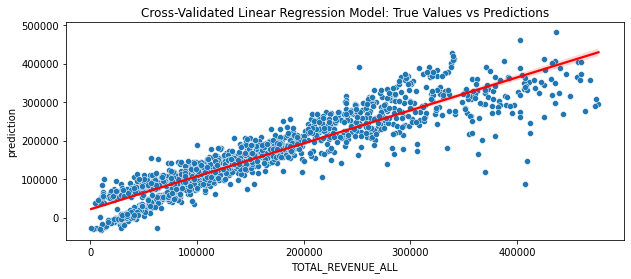

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the figure size
plt.figure(figsize=(10, 4))

# Convert the predictions DataFrame to Pandas for visualization
cv_predictions_df = cv_predictions.select('TOTAL_REVENUE_ALL', 'prediction').toPandas()

# Scatter plot of True Values vs Predictions
sns.scatterplot(x='TOTAL_REVENUE_ALL', y='prediction', data=cv_predictions_df)

# Set labels and title
plt.xlabel('True Values')
plt.ylabel('Predictions')
plt.title('Cross-Validated Linear Regression Model: True Values vs Predictions')

# Overlay a regression line
sns.regplot(x='TOTAL_REVENUE_ALL', y='prediction', data=cv_predictions_df, scatter=False, color='red')

# Show the plot
plt.show()


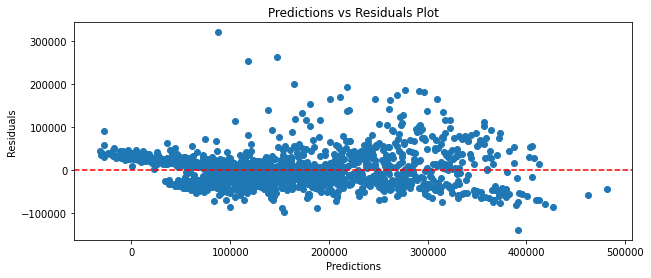

In [ ]:
import matplotlib.pyplot as plt

# Convert the cross-validated predictions DataFrame to Pandas for visualization
cv_residuals_df = cv_predictions.select('TOTAL_REVENUE_ALL', 'prediction').toPandas()
cv_residuals_df['residuals'] = cv_residuals_df['TOTAL_REVENUE_ALL'] - cv_residuals_df['prediction']

# Set the figure size
plt.figure(figsize=(10, 4))

# Scatter plot of Predictions vs Residuals
plt.scatter(cv_residuals_df['prediction'], cv_residuals_df['residuals'])

# Add a horizontal line at y=0 for reference
plt.axhline(y=0, color='red', linestyle='--')

# Set labels and title
plt.xlabel('Predictions')
plt.ylabel('Residuals')
plt.title('Predictions vs Residuals Plot')

# Show the plot
plt.show()

In [ ]:
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml import Pipeline
from sklearn.metrics import mean_squared_error, r2_score

# List of features and target variable
features = ['TOTAL_OPEXP_MENWOMEN', 'PARTIC_MEN', 'PARTIC_WOMEN', 'MEN_TOTAL_HEADCOACH',
            'WOMEN_TOTAL_HDCOACH', 'PARTIC_COED_MEN', 'PARTIC_COED_WOMEN', 'EXP_MEN', 'EXP_WOMEN']
target = 'TOTAL_REVENUE_ALL'

# Vector Assembler for combining features into a single vector column
vector_assembler = VectorAssembler(inputCols=features, outputCol='features')
df_assembled = vector_assembler.transform(data)

# Split the data into training and testing sets
train_df, test_df = df_assembled.randomSplit([0.8, 0.2], seed=42)

# Random Forest Regressor
rf_model = RandomForestRegressor(featuresCol='features', labelCol=target, numTrees=100, seed=42)

# Pipeline
pipeline = Pipeline(stages=[rf_model])

# Fit the model
model = pipeline.fit(train_df)

# Make predictions on the test set
predictions = model.transform(test_df)

# Extract predicted and true values for evaluation
y_pred = predictions.select('prediction').toPandas()['prediction']
y_test = test_df.select(target).toPandas()[target]

# Evaluate the model
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print evaluation metrics
print(f"Mean Squared Error (MSE): {mse}")
print(f"R-squared (R2): {r2}")


Mean Squared Error (MSE): 937354631.2347801
R-squared (R2): 0.9212383103869257


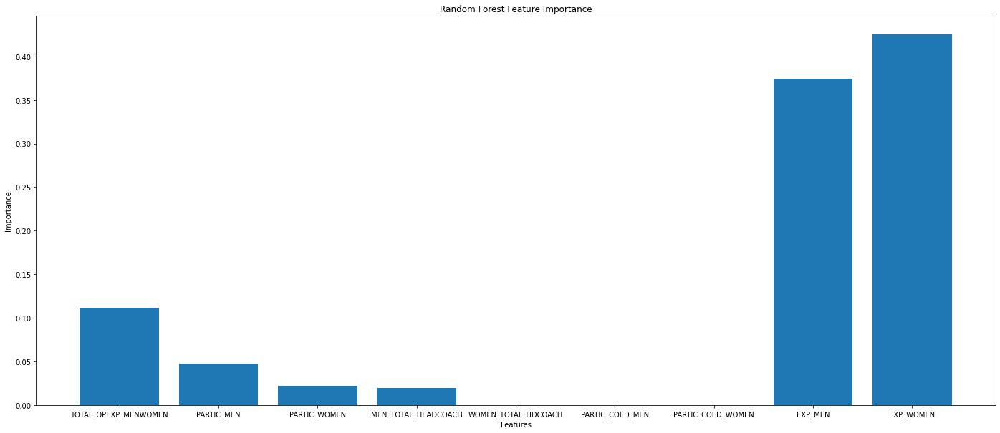

In [ ]:
# Extract feature importances from the RandomForestRegressor model
importances = model.stages[-1].featureImportances.toArray()

# Plot the feature importances using a bar chart
plt.figure(figsize=(24, 10))
plt.bar(features, importances)
plt.title('Random Forest Feature Importance')
plt.xlabel('Features')
plt.ylabel('Importance')
plt.show()


## 2. How does gender equity impact the financial aspects of sports programs, such as revenues and expenses?
### Performing visualization to view the financial aspects with respect to gender.

In [ ]:
# Import necessary functions and classes
from pyspark.sql.functions import when
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.classification import LogisticRegression
from pyspark.ml import Pipeline

# Define the features and financial metric columns
features = ['EFMaleCount', 'EFFemaleCount', 'EFTotalCount', 'TOTAL_OPEXP_MENWOMEN', 
            'PARTIC_MEN', 'PARTIC_WOMEN', 'MEN_TOTAL_HEADCOACH', 'WOMEN_TOTAL_HDCOACH',
            'PARTIC_COED_MEN', 'PARTIC_COED_WOMEN', 'EXP_WOMEN']
financial_metric = 'TOTAL_REVENUE_ALL'

# Set a threshold for classifying as HighRevenue
threshold = 100000 

# Create a new binary column 'HighRevenue' based on the threshold
data = data.withColumn('HighRevenue', when(data[financial_metric] >= threshold, 1).otherwise(0))

# Create a VectorAssembler to combine features into a single vector column
assembler = VectorAssembler(inputCols=features, outputCol='features')

# Create a Logistic Regression model
lr = LogisticRegression(featuresCol='features', labelCol='HighRevenue')

# Create a pipeline with the VectorAssembler and Logistic Regression stages
pipeline = Pipeline(stages=[assembler, lr])

# Split the data into training and testing sets
(train_data, test_data) = data.randomSplit([0.8, 0.2], seed=42)

# Fit the Logistic Regression model on the training data
lr_model = pipeline.fit(train_data)

# Make predictions on the test data
predictions = lr_model.transform(test_data)


In [ ]:

predictions.select("HighRevenue", "TOTAL_REVENUE_ALL").show()


+-----------+-----------------+
|HighRevenue|TOTAL_REVENUE_ALL|
+-----------+-----------------+
|          1|           126246|
|          1|           158012|
|          1|           350343|
|          1|           237939|
|          0|            61473|
|          1|           180920|
|          1|           100184|
|          1|           372621|
|          1|           211267|
|          0|            79887|
|          0|            58233|
|          0|            81093|
|          1|           233066|
|          1|           131398|
|          0|            27030|
|          0|            22440|
|          1|           124759|
|          0|            73978|
|          0|            87100|
|          0|            77086|
+-----------+-----------------+
only showing top 20 rows



In [ ]:
# Import necessary evaluation metrics
from pyspark.ml.evaluation import BinaryClassificationEvaluator, MulticlassClassificationEvaluator

# Create BinaryClassificationEvaluator and MulticlassClassificationEvaluator instances
binary_evaluator = BinaryClassificationEvaluator(labelCol='HighRevenue')
multiclass_evaluator = MulticlassClassificationEvaluator(labelCol='HighRevenue', metricName='f1')

# Evaluate the model using Binary Classification metrics
roc_auc = binary_evaluator.evaluate(predictions, {binary_evaluator.metricName: 'areaUnderROC'})

# Evaluate the model using Multiclass Classification metrics (precision, recall, F1-score)
precision = multiclass_evaluator.evaluate(predictions, {multiclass_evaluator.metricName: 'precisionByLabel'})
recall = multiclass_evaluator.evaluate(predictions, {multiclass_evaluator.metricName: 'recallByLabel'})
f1_score = multiclass_evaluator.evaluate(predictions, {multiclass_evaluator.metricName: 'f1'})

# Calculate accuracy manually
accuracy = predictions.filter(predictions.HighRevenue == predictions.prediction).count() / predictions.count()

# Print the evaluation metrics
print(f"Area under ROC curve: {roc_auc}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1-score: {f1_score}")
print(f"Accuracy: {accuracy}")


Area under ROC curve: 0.9930638766519837
Precision: 0.952
Recall: 0.952
F1-score: 0.9659090909090908
Accuracy: 0.9659090909090909


In [ ]:
# Import necessary modules
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.evaluation import BinaryClassificationEvaluator

# Define the features used for modeling
features = ['EFMaleCount', 'EFFemaleCount', 'EFTotalCount', 'TOTAL_OPEXP_MENWOMEN', 
            'PARTIC_MEN', 'PARTIC_WOMEN', 'MEN_TOTAL_HEADCOACH', 'WOMEN_TOTAL_HDCOACH',
            'PARTIC_COED_MEN', 'PARTIC_COED_WOMEN', 'EXP_WOMEN']

# Create a VectorAssembler to combine features into a single vector column
assembler = VectorAssembler(inputCols=features, outputCol='features')
data_with_features = assembler.transform(data)

# Split the data into training and testing sets
train_data, test_data = data_with_features.randomSplit([0.8, 0.2], seed=42)

# Create a DecisionTreeClassifier
dt_classifier = DecisionTreeClassifier(featuresCol='features', labelCol='HighRevenue')

# Train the model
dt_model = dt_classifier.fit(train_data)

# Make predictions on the test set
dt_predictions = dt_model.transform(test_data)

# Evaluate the model using Binary Classification metrics (AUC-ROC)
dt_binary_evaluator = BinaryClassificationEvaluator(labelCol='HighRevenue')
dt_auc_roc = dt_binary_evaluator.evaluate(dt_predictions, {dt_binary_evaluator.metricName: 'areaUnderROC'})

# Print the AUC-ROC
print(f"Decision Tree AUC-ROC: {dt_auc_roc}")


Decision Tree AUC-ROC: 0.9682654185022026


In [ ]:
# Import necessary modules
from pyspark.ml.classification import DecisionTreeClassifier
from pyspark.ml.feature import VectorAssembler
from pyspark.ml import Pipeline

# List of selected features
features = ['EFMaleCount', 'EFFemaleCount', 'EFTotalCount', 'TOTAL_OPEXP_MENWOMEN', 
            'PARTIC_MEN', 'PARTIC_WOMEN', 'MEN_TOTAL_HEADCOACH', 'WOMEN_TOTAL_HDCOACH',
            'PARTIC_COED_MEN', 'PARTIC_COED_WOMEN', 'EXP_WOMEN','WOMEN_TOTAL_ASTCOACH', 'TOTAL_OPEXP_MENWOMEN', 'TOTAL_OPEXP_COEDTEAM', 'TOTAL_OPEXP_INCLCOED', 'TOTAL_REV_COED']

# Create a VectorAssembler to combine features into a single vector column
assembler = VectorAssembler(inputCols=features, outputCol='my_features')

# Create a DecisionTreeClassifier
dt_classifier = DecisionTreeClassifier(featuresCol='my_features', labelCol='HighRevenue')

# Create a Pipeline to streamline the workflow
pipeline = Pipeline(stages=[assembler, dt_classifier])

# Fit the pipeline to the training data
dt_model = pipeline.fit(train_data)

# Extract the final DecisionTree model from the pipeline
tree_model = dt_model.stages[-1]

# Get the names of the features used in the model
feature_names = assembler.getInputCols()

# Print the debug string of the DecisionTree model
print(tree_model.toDebugString)

# Display the DecisionTree model using Databricks display function
display(tree_model)


DecisionTreeClassificationModel: uid=DecisionTreeClassifier_2bd24859ede4, depth=5, numNodes=37, numClasses=2, numFeatures=16
  If (feature 10 <= 48313.0)
   If (feature 3 <= 40172.0)
    If (feature 10 <= 43114.0)
     Predict: 0.0
    Else (feature 10 > 43114.0)
     If (feature 4 <= 5.5)
      Predict: 0.0
     Else (feature 4 > 5.5)
      If (feature 4 <= 32.5)
       Predict: 0.0
      Else (feature 4 > 32.5)
       Predict: 1.0
   Else (feature 3 > 40172.0)
    If (feature 3 <= 61290.5)
     If (feature 5 <= 19.5)
      If (feature 10 <= 38697.0)
       Predict: 0.0
      Else (feature 10 > 38697.0)
       Predict: 1.0
     Else (feature 5 > 19.5)
      Predict: 0.0
    Else (feature 3 > 61290.5)
     If (feature 10 <= 38697.0)
      If (feature 5 <= 8.5)
       Predict: 1.0
      Else (feature 5 > 8.5)
       Predict: 0.0
     Else (feature 10 > 38697.0)
      If (feature 0 <= 132.5)
       Predict: 0.0
      Else (feature 0 > 132.5)
       Predict: 1.0
  Else (feature 10 > 48313

treeNode
"{""index"":21,""featureType"":""continuous"",""prediction"":null,""threshold"":48313.0,""categories"":null,""feature"":10,""overflow"":false}"
"{""index"":7,""featureType"":""continuous"",""prediction"":null,""threshold"":40172.0,""categories"":null,""feature"":3,""overflow"":false}"
"{""index"":1,""featureType"":""continuous"",""prediction"":null,""threshold"":43114.0,""categories"":null,""feature"":10,""overflow"":false}"
"{""index"":0,""featureType"":null,""prediction"":0.0,""threshold"":null,""categories"":null,""feature"":null,""overflow"":false}"
"{""index"":3,""featureType"":""continuous"",""prediction"":null,""threshold"":5.5,""categories"":null,""feature"":4,""overflow"":false}"
"{""index"":2,""featureType"":null,""prediction"":0.0,""threshold"":null,""categories"":null,""feature"":null,""overflow"":false}"
"{""index"":5,""featureType"":""continuous"",""prediction"":null,""threshold"":32.5,""categories"":null,""feature"":4,""overflow"":false}"
"{""index"":4,""featureType"":null,""prediction"":0.0,""threshold"":null,""categories"":null,""feature"":null,""overflow"":false}"
"{""index"":6,""featureType"":null,""prediction"":1.0,""threshold"":null,""categories"":null,""feature"":null,""overflow"":false}"
"{""index"":13,""featureType"":""continuous"",""prediction"":null,""threshold"":61290.5,""categories"":null,""feature"":3,""overflow"":false}"


In [ ]:
# Get the names of the features used in the model
feature_names = assembler.getInputCols()

# Print the DecisionTreeClassificationModel
print("DecisionTreeClassificationModel:")
print(tree_model)

# Print the Decision Tree Rules with feature names
print("\nDecision Tree Rules:")
for i in range(len(feature_names)):
    # Replace generic feature names with actual feature names
    tree_rules = tree_model.toDebugString.replace("feature " + str(i), feature_names[i])
    print(tree_rules)


DecisionTreeClassificationModel:
DecisionTreeClassificationModel: uid=DecisionTreeClassifier_2bd24859ede4, depth=5, numNodes=37, numClasses=2, numFeatures=16

Decision Tree Rules:
DecisionTreeClassificationModel: uid=DecisionTreeClassifier_2bd24859ede4, depth=5, numNodes=37, numClasses=2, numFeatures=16
  If (feature 10 <= 48313.0)
   If (feature 3 <= 40172.0)
    If (feature 10 <= 43114.0)
     Predict: 0.0
    Else (feature 10 > 43114.0)
     If (feature 4 <= 5.5)
      Predict: 0.0
     Else (feature 4 > 5.5)
      If (feature 4 <= 32.5)
       Predict: 0.0
      Else (feature 4 > 32.5)
       Predict: 1.0
   Else (feature 3 > 40172.0)
    If (feature 3 <= 61290.5)
     If (feature 5 <= 19.5)
      If (feature 10 <= 38697.0)
       Predict: 0.0
      Else (feature 10 > 38697.0)
       Predict: 1.0
     Else (feature 5 > 19.5)
      Predict: 0.0
    Else (feature 3 > 61290.5)
     If (feature 10 <= 38697.0)
      If (feature 5 <= 8.5)
       Predict: 1.0
      Else (feature 5 > 8.5)


In [ ]:
# Import confusion_matrix from scikit-learn
from sklearn.metrics import confusion_matrix

# Extract true labels and predicted labels from Spark DataFrame to Pandas
y_true = dt_predictions.select("HighRevenue").toPandas()
y_pred = dt_predictions.select("prediction").toPandas()

# Calculate confusion matrix
conf_matrix = confusion_matrix(y_true, y_pred)

# Print the confusion matrix
print("Confusion Matrix:")
print(conf_matrix)


Confusion Matrix:
[[479  21]
 [ 29 879]]


In [ ]:
# Import necessary metrics from scikit-learn
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# Calculate and print accuracy, precision, recall, and F1-score
accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred)
recall = recall_score(y_true, y_pred)
f1 = f1_score(y_true, y_pred)

print(f"Accuracy: {accuracy}")
print(f"Precision: {precision}")
print(f"Recall: {recall}")
print(f"F1-Score: {f1}")


Accuracy: 0.9644886363636364
Precision: 0.9766666666666667
Recall: 0.9680616740088106
F1-Score: 0.972345132743363


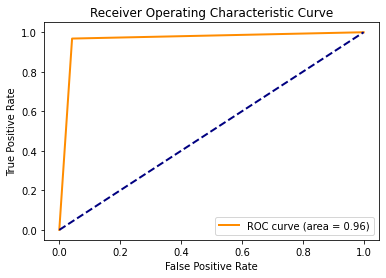

In [ ]:
# Import necessary libraries
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

# Calculate ROC curve and AUC
fpr, tpr, _ = roc_curve(y_true, y_pred)
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = {:.2f})'.format(roc_auc))
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic Curve')
plt.legend(loc="lower right")
plt.show()


In [ ]:
# Creating dataframe for visualizations
df2 = df[['institution_name','REVENUE_MENALL','REVENUE_WOMENALL','EXPENSE_MENALL','EXPENSE_WOMENALL','SUM_PARTIC_MEN','SUM_PARTIC_WOMEN','Sports','state_cd']]
df2.display()

institution_name,REVENUE_MENALL,REVENUE_WOMENALL,EXPENSE_MENALL,EXPENSE_WOMENALL,SUM_PARTIC_MEN,SUM_PARTIC_WOMEN,Sports,state_cd
Alabama A & M University,275210,0,297153,0,37,0,Baseball,AL
Alabama A & M University,1450494,1258462,1132578,1067456,14,17,Basketball,AL
Alabama A & M University,4119664,0,3437529,0,96,0,Football,AL
Alabama A & M University,64347,0,59524,0,7,0,Golf,AL
Alabama A & M University,0,494874,0,355614,0,31,Soccer,AL
Alabama A & M University,0,292408,0,379150,0,24,Softball,AL
Alabama A & M University,103652,144623,151865,194398,9,8,Tennis,AL
Alabama A & M University,68974,278436,94724,227855,18,19,Track and Field (Indoor),AL
Alabama A & M University,68734,197810,97648,211987,18,19,Track and Field (Outdoor),AL
Alabama A & M University,0,22465,0,73125,0,6,Cross Country,AL


In [ ]:
# Grouping dataframe by SPORTS
df2_s = df2.groupby(['Sports']).sum()
df2_s.display()

Sports,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN)
Gymnastics,3464379,60822052,9703252,94402543,212,2075
Field Hockey,0,101078092,0,111424713,0,6366
Tennis,162637111,224716578,189360775,258135074,9340,10254
Track and Field (Indoor),20481461,23175853,19845212,22357435,7706,6984
Ice Hockey,176631754,72886721,179949261,82210720,4715,2944
Golf,223294677,200244202,240058140,216135697,11917,7480
Rowing,33948410,103826890,37792307,131285597,2620,6606
Softball,0,561567961,0,625250552,0,34446
Sailing,4401011,7770131,4293636,7718456,386,650
Swimming,39127701,53220774,41941391,58932557,4366,5188


In [ ]:
# Finding the average Revenue and Expenditure for each Men and Women respectively
df3_s = df2_s.withColumn('avg_rev_men', col('sum(REVENUE_MENALL)') / col('sum(SUM_PARTIC_MEN)'))
df4_s = df3_s.withColumn('avg_rev_women', col('sum(REVENUE_WOMENALL)') / col('sum(SUM_PARTIC_WOMEN)'))
df5_s = df4_s.withColumn('avg_exp_men', col('sum(EXPENSE_MENALL)') / col('sum(SUM_PARTIC_MEN)'))
df6_s = df5_s.withColumn('avg_exp_women', col('sum(EXPENSE_WOMENALL)') / col('sum(SUM_PARTIC_WOMEN)'))
display(df6_s)

Sports,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN),avg_rev_men,avg_rev_women,avg_exp_men,avg_exp_women
Gymnastics,3464379,60822052,9703252,94402543,212,2075,16341.41037735849,29311.832289156628,45770.056603773584,45495.20144578313
Field Hockey,0,101078092,0,111424713,0,6366,null,15877.802701853598,null,17503.096606974552
Tennis,162637111,224716578,189360775,258135074,9340,10254,17412.96691648822,21915.016383850205,20274.172912205566,25174.085625121905
Track and Field (Indoor),20481461,23175853,19845212,22357435,7706,6984,2657.858941084869,3318.4211053837344,2575.2935375032444,3201.236397479954
Ice Hockey,176631754,72886721,179949261,82210720,4715,2944,37461.665747613995,24757.71773097826,38165.27274655355,27924.83695652174
Golf,223294677,200244202,240058140,216135697,11917,7480,18737.4907275321,26770.61524064171,20144.175547537132,28895.146657754012
Rowing,33948410,103826890,37792307,131285597,2620,6606,12957.408396946565,15717.058734483802,14424.54465648855,19873.69013018468
Softball,0,561567961,0,625250552,0,34446,null,16302.849706787436,null,18151.61563026186
Sailing,4401011,7770131,4293636,7718456,386,650,11401.582901554404,11954.047692307693,11123.409326424871,11874.547692307693
Swimming,39127701,53220774,41941391,58932557,4366,5188,8961.910444342648,10258.437548188127,9606.365322950069,11359.39803392444


In [ ]:
# Finding the rate of profit for Men and Women respectively
df7_s = df6_s.withColumn('rate_profit_men', col('avg_rev_men') / col('avg_exp_men'))
df8_s = df7_s.withColumn('rate_profit_women', col('avg_rev_women') / col('avg_exp_women'))
display(df8_s)

Sports,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN),avg_rev_men,avg_rev_women,avg_exp_men,avg_exp_women,rate_profit_men,rate_profit_women
Gymnastics,3464379,60822052,9703252,94402543,212,2075,16341.41037735849,29311.832289156628,45770.056603773584,45495.20144578313,0.357032776228011,0.6442840422211932
Field Hockey,0,101078092,0,111424713,0,6366,null,15877.802701853598,null,17503.096606974552,null,0.907142493604628
Tennis,162637111,224716578,189360775,258135074,9340,10254,17412.96691648822,21915.016383850205,20274.172912205566,25174.085625121905,0.8588743418482524,0.8705387242339644
Track and Field (Indoor),20481461,23175853,19845212,22357435,7706,6984,2657.858941084869,3318.4211053837344,2575.2935375032444,3201.236397479954,1.0320605796501443,1.036606077575536
Ice Hockey,176631754,72886721,179949261,82210720,4715,2944,37461.665747613995,24757.71773097826,38165.27274655355,27924.83695652174,0.9815642088132832,0.886584146203804
Golf,223294677,200244202,240058140,216135697,11917,7480,18737.4907275321,26770.61524064171,20144.175547537132,28895.146657754012,0.9301691540224382,0.9264744546107994
Rowing,33948410,103826890,37792307,131285597,2620,6606,12957.408396946565,15717.058734483802,14424.54465648855,19873.69013018468,0.8982889030828417,0.7908475291467044
Softball,0,561567961,0,625250552,0,34446,null,16302.849706787436,null,18151.61563026186,null,0.8981486848811291
Sailing,4401011,7770131,4293636,7718456,386,650,11401.582901554404,11954.047692307693,11123.409326424871,11874.547692307693,1.0250079419866984,1.0066949918481105
Swimming,39127701,53220774,41941391,58932557,4366,5188,8961.910444342648,10258.437548188127,9606.365322950069,11359.39803392444,0.9329137653064487,0.9030793284601584


In [ ]:
# Finding the rate of profit difference between Men and Women
df8_s = df8_s.fillna(0)
df9_s = df8_s.withColumn('diff_men_women', col('rate_profit_men') - col('rate_profit_women'))
display(df9_s)
# Scatter plot of average revenue againts average expenditure for men and women in each sport.

Sports,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN),avg_rev_men,avg_rev_women,avg_exp_men,avg_exp_women,rate_profit_men,rate_profit_women,diff_men_women
Gymnastics,3464379,60822052,9703252,94402543,212,2075,16341.41037735849,29311.832289156628,45770.056603773584,45495.20144578313,0.357032776228011,0.6442840422211932,-0.2872512659931822
Field Hockey,0,101078092,0,111424713,0,6366,0.0,15877.802701853598,0.0,17503.096606974552,0.0,0.907142493604628,-0.907142493604628
Tennis,162637111,224716578,189360775,258135074,9340,10254,17412.96691648822,21915.016383850205,20274.172912205566,25174.085625121905,0.8588743418482524,0.8705387242339644,-0.011664382385711991
Track and Field (Indoor),20481461,23175853,19845212,22357435,7706,6984,2657.858941084869,3318.4211053837344,2575.2935375032444,3201.236397479954,1.0320605796501443,1.036606077575536,-0.004545497925391606
Ice Hockey,176631754,72886721,179949261,82210720,4715,2944,37461.665747613995,24757.71773097826,38165.27274655355,27924.83695652174,0.9815642088132832,0.886584146203804,0.09498006260947922
Golf,223294677,200244202,240058140,216135697,11917,7480,18737.4907275321,26770.61524064171,20144.175547537132,28895.146657754012,0.9301691540224382,0.9264744546107994,0.003694699411638802
Rowing,33948410,103826890,37792307,131285597,2620,6606,12957.408396946565,15717.058734483802,14424.54465648855,19873.69013018468,0.8982889030828417,0.7908475291467044,0.10744137393613729
Softball,0,561567961,0,625250552,0,34446,0.0,16302.849706787436,0.0,18151.61563026186,0.0,0.8981486848811291,-0.8981486848811291
Sailing,4401011,7770131,4293636,7718456,386,650,11401.582901554404,11954.047692307693,11123.409326424871,11874.547692307693,1.0250079419866984,1.0066949918481105,0.018312950138587913
Swimming,39127701,53220774,41941391,58932557,4366,5188,8961.910444342648,10258.437548188127,9606.365322950069,11359.39803392444,0.9329137653064487,0.9030793284601584,0.02983443684629028


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

In [ ]:
df9_s.createOrReplaceTempView("table2")

In [ ]:
# Visualizing the difference in rate of profit between Men and Women.

In [ ]:
%sql
select Sports,diff_men_women 
from table2;

Sports,diff_men_women
Gymnastics,-0.2872512659931822
Field Hockey,-0.907142493604628
Tennis,-0.011664382385711991
Track and Field (Indoor),-0.004545497925391606
Ice Hockey,0.09498006260947922
Golf,0.003694699411638802
Rowing,0.10744137393613729
Softball,-0.8981486848811291
Sailing,0.018312950138587913
Swimming,0.02983443684629028


Databricks visualization. Run in Databricks to view.

In [ ]:
# Visualizing the rate of profit for Men and Women in each sport (vertically & horizontally)

In [ ]:
%sql
select Sports,
rate_profit_men as Male,
rate_profit_women as Female
from table2;

Sports,Male,Female
Gymnastics,0.357032776228011,0.6442840422211932
Field Hockey,0.0,0.907142493604628
Tennis,0.8588743418482524,0.8705387242339644
Track and Field (Indoor),1.0320605796501443,1.036606077575536
Ice Hockey,0.9815642088132832,0.886584146203804
Golf,0.9301691540224382,0.9264744546107994
Rowing,0.8982889030828417,0.7908475291467044
Softball,0.0,0.8981486848811291
Sailing,1.0250079419866984,1.0066949918481105
Swimming,0.9329137653064487,0.9030793284601584


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

In [ ]:
# Finding out which sport has highest rate of returns for Men

In [ ]:
%sql
select Sports,
rate_profit_men as Male_Max
from table2
where rate_profit_men = ( SELECT MAX(rate_profit_men) FROM table2 );

Sports,Male_Max
Football,1.4265114946032509


In [ ]:
# Finding out which sport has highest rate of returns for Women

In [ ]:
%sql
select Sports,
rate_profit_women as Female_Max
from table2
where rate_profit_women = ( SELECT MAX(rate_profit_women) FROM table2 );

Sports,Female_Max
Rifle,1.0504233059991368


In [ ]:
# Finding out which sport has least rate of returns for Men

In [ ]:
%sql
select Sports,
rate_profit_men as Male_Min
from table2
where rate_profit_men = ( SELECT MIN(NULLIF(rate_profit_men, 0)) FROM table2 );

Sports,Male_Min
Gymnastics,0.357032776228011


In [ ]:
# Finding out which sport has least rate of returns for Women

In [ ]:
%sql
select Sports,
rate_profit_women as Female_Min
from table2
where rate_profit_women = ( SELECT MIN(NULLIF(rate_profit_women, 0)) FROM table2 );

Sports,Female_Min
Diving,0.5387018521441365


In [ ]:
# Creating a dataframe with respect to each state
df2_st = df2.groupby(['state_cd']).sum()
df2_st.display()

state_cd,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN)
AZ,199193251,65047127,151179390,78365721,3611,2807
LA,233554100,70479066,200777855,93184078,4393,3195
MN,160995895,54879246,122247773,74520739,8648,6696
NJ,158635271,98904605,158110911,98396963,8185,5973
DC,52845324,40987725,52581281,40766645,1748,1748
KY,241062109,104761999,239112305,104488072,7367,5481
NH,38750791,32185068,38322421,32037100,2990,2531
MI,440872740,107669265,314820586,148817072,12616,9604
NV,44137418,17966429,42502826,17966428,554,585
ID,53219362,23315788,45278439,28616078,1599,1437


In [ ]:
# Removing the "null" row
mask = df2_st['state_cd'] == 'null'
df2_st = df2_st[~mask]
df2_st.display()

state_cd,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN)
AZ,199193251,65047127,151179390,78365721,3611,2807
LA,233554100,70479066,200777855,93184078,4393,3195
MN,160995895,54879246,122247773,74520739,8648,6696
NJ,158635271,98904605,158110911,98396963,8185,5973
DC,52845324,40987725,52581281,40766645,1748,1748
KY,241062109,104761999,239112305,104488072,7367,5481
NH,38750791,32185068,38322421,32037100,2990,2531
MI,440872740,107669265,314820586,148817072,12616,9604
NV,44137418,17966429,42502826,17966428,554,585
ID,53219362,23315788,45278439,28616078,1599,1437


In [ ]:
# Finding the average revenue and expenditure for men and women each
df3_st = df2_st.withColumn('avg_rev_men', col('sum(REVENUE_MENALL)') / col('sum(SUM_PARTIC_MEN)'))
df4_st = df3_st.withColumn('avg_rev_women', col('sum(REVENUE_WOMENALL)') / col('sum(SUM_PARTIC_WOMEN)'))
df5_st = df4_st.withColumn('avg_exp_men', col('sum(EXPENSE_MENALL)') / col('sum(SUM_PARTIC_MEN)'))
df6_st = df5_st.withColumn('avg_exp_women', col('sum(EXPENSE_WOMENALL)') / col('sum(SUM_PARTIC_WOMEN)'))
display(df6_st)

state_cd,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN),avg_rev_men,avg_rev_women,avg_exp_men,avg_exp_women
AZ,199193251,65047127,151179390,78365721,3611,2807,55162.90528939352,23173.183826148914,41866.35004153974,27917.96259351621
LA,233554100,70479066,200777855,93184078,4393,3195,53165.05804689279,22059.17558685446,45704.04165718188,29165.595618153366
MN,160995895,54879246,122247773,74520739,8648,6696,18616.546600370028,8195.825268817205,14135.958950046253,11129.142622461171
NJ,158635271,98904605,158110911,98396963,8185,5973,19381.218204031764,16558.614599028962,19317.154673182653,16473.625146492548
DC,52845324,40987725,52581281,40766645,1748,1748,30231.87871853547,23448.355263157893,30080.824370709382,23321.87929061785
KY,241062109,104761999,239112305,104488072,7367,5481,32721.88258449844,19113.665207079,32457.215284376274,19063.68764823937
NH,38750791,32185068,38322421,32037100,2990,2531,12960.13076923077,12716.344527854602,12816.86321070234,12657.882259976293
MI,440872740,107669265,314820586,148817072,12616,9604,34945.524730500954,11210.877238650563,24954.07308180089,15495.321949187839
NV,44137418,17966429,42502826,17966428,554,585,79670.42960288809,30711.844444444443,76719.90252707581,30711.842735042734
ID,53219362,23315788,45278439,28616078,1599,1437,33282.90306441526,16225.322199025748,28316.722326454033,19913.763395963815


In [ ]:
# Finding the rate of profit for men and women respectively
df7_st = df6_st.withColumn('rate_profit_men', col('avg_rev_men') / col('avg_exp_men'))
df8_st = df7_st.withColumn('rate_profit_women', col('avg_rev_women') / col('avg_exp_women'))
display(df8_st)

state_cd,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN),avg_rev_men,avg_rev_women,avg_exp_men,avg_exp_women,rate_profit_men,rate_profit_women
AZ,199193251,65047127,151179390,78365721,3611,2807,55162.90528939352,23173.183826148914,41866.35004153974,27917.96259351621,1.3175952820023946,0.8300456649917124
LA,233554100,70479066,200777855,93184078,4393,3195,53165.05804689279,22059.17558685446,45704.04165718188,29165.595618153366,1.1632463151874992,0.7563423656989985
MN,160995895,54879246,122247773,74520739,8648,6696,18616.546600370028,8195.825268817205,14135.958950046253,11129.142622461171,1.3169638272265296,0.7364291704085222
NJ,158635271,98904605,158110911,98396963,8185,5973,19381.218204031764,16558.614599028962,19317.154673182653,16473.625146492548,1.0033164061650368,1.0051591226448726
DC,52845324,40987725,52581281,40766645,1748,1748,30231.87871853547,23448.355263157893,30080.824370709382,23321.87929061785,1.0050216159625325,1.0054230609362138
KY,241062109,104761999,239112305,104488072,7367,5481,32721.88258449844,19113.665207079,32457.215284376274,19063.68764823937,1.008154344043482,1.0026216102446603
NH,38750791,32185068,38322421,32037100,2990,2531,12960.13076923077,12716.344527854602,12816.86321070234,12657.882259976293,1.0111780516163111,1.0046186452581538
MI,440872740,107669265,314820586,148817072,12616,9604,34945.524730500954,11210.877238650563,24954.07308180089,15495.321949187839,1.4003936197488687,0.7235007620631052
NV,44137418,17966429,42502826,17966428,554,585,79670.42960288809,30711.844444444443,76719.90252707581,30711.842735042734,1.0384584309758604,1.0000000556593664
ID,53219362,23315788,45278439,28616078,1599,1437,33282.90306441526,16225.322199025748,28316.722326454033,19913.763395963815,1.1753797872757936,0.8147792999445975


In [ ]:
# Finding the difference between the rate of profit for men and women
df8_st = df8_st.fillna(0)
df9_st = df8_st.withColumn('diff_men_women', col('rate_profit_men') - col('rate_profit_women'))
display(df9_st)
# Choropleth map of each state displaying their difference in rate of profit for men and women.
# Scatter plots of Average revenue against average expenditure for men and women with respect to their state.

state_cd,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN),avg_rev_men,avg_rev_women,avg_exp_men,avg_exp_women,rate_profit_men,rate_profit_women,diff_men_women
AZ,199193251,65047127,151179390,78365721,3611,2807,55162.90528939352,23173.183826148914,41866.35004153974,27917.96259351621,1.3175952820023946,0.8300456649917124,0.4875496170106822
LA,233554100,70479066,200777855,93184078,4393,3195,53165.05804689279,22059.17558685446,45704.04165718188,29165.595618153366,1.1632463151874992,0.7563423656989985,0.4069039494885007
MN,160995895,54879246,122247773,74520739,8648,6696,18616.546600370028,8195.825268817205,14135.958950046253,11129.142622461171,1.3169638272265296,0.7364291704085222,0.5805346568180074
NJ,158635271,98904605,158110911,98396963,8185,5973,19381.218204031764,16558.614599028962,19317.154673182653,16473.625146492548,1.0033164061650368,1.0051591226448726,-0.0018427164798358042
DC,52845324,40987725,52581281,40766645,1748,1748,30231.87871853547,23448.355263157893,30080.824370709382,23321.87929061785,1.0050216159625325,1.0054230609362138,-4.014449736813308E-4
KY,241062109,104761999,239112305,104488072,7367,5481,32721.88258449844,19113.665207079,32457.215284376274,19063.68764823937,1.008154344043482,1.0026216102446603,0.005532733798821576
NH,38750791,32185068,38322421,32037100,2990,2531,12960.13076923077,12716.344527854602,12816.86321070234,12657.882259976293,1.0111780516163111,1.0046186452581538,0.006559406358157327
MI,440872740,107669265,314820586,148817072,12616,9604,34945.524730500954,11210.877238650563,24954.07308180089,15495.321949187839,1.4003936197488687,0.7235007620631052,0.6768928576857635
NV,44137418,17966429,42502826,17966428,554,585,79670.42960288809,30711.844444444443,76719.90252707581,30711.842735042734,1.0384584309758604,1.0000000556593664,0.03845837531649399
ID,53219362,23315788,45278439,28616078,1599,1437,33282.90306441526,16225.322199025748,28316.722326454033,19913.763395963815,1.1753797872757936,0.8147792999445975,0.3606004873311961


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

In [ ]:
df10_st = df9_st.withColumn('exp_diff_men_women', col('avg_exp_men') - col('avg_exp_women'))
df11_st = df10_st.withColumn('rev_diff_men_women', col('avg_rev_men') - col('avg_rev_women'))
display(df11_st)
# Choropleth maps of each state displaying their difference in expenditure and revenue for men and women.

state_cd,sum(REVENUE_MENALL),sum(REVENUE_WOMENALL),sum(EXPENSE_MENALL),sum(EXPENSE_WOMENALL),sum(SUM_PARTIC_MEN),sum(SUM_PARTIC_WOMEN),avg_rev_men,avg_rev_women,avg_exp_men,avg_exp_women,rate_profit_men,rate_profit_women,diff_men_women,exp_diff_men_women,rev_diff_men_women
AZ,199193251,65047127,151179390,78365721,3611,2807,55162.90528939352,23173.183826148914,41866.35004153974,27917.96259351621,1.3175952820023946,0.8300456649917124,0.4875496170106822,13948.387448023532,31989.72146324461
LA,233554100,70479066,200777855,93184078,4393,3195,53165.05804689279,22059.17558685446,45704.04165718188,29165.595618153366,1.1632463151874992,0.7563423656989985,0.4069039494885007,16538.446039028513,31105.882460038327
MN,160995895,54879246,122247773,74520739,8648,6696,18616.546600370028,8195.825268817205,14135.958950046253,11129.142622461171,1.3169638272265296,0.7364291704085222,0.5805346568180074,3006.816327585082,10420.721331552822
NJ,158635271,98904605,158110911,98396963,8185,5973,19381.218204031764,16558.614599028962,19317.154673182653,16473.625146492548,1.0033164061650368,1.0051591226448726,-0.0018427164798358042,2843.529526690105,2822.6036050028015
DC,52845324,40987725,52581281,40766645,1748,1748,30231.87871853547,23448.355263157893,30080.824370709382,23321.87929061785,1.0050216159625325,1.0054230609362138,-4.014449736813308E-4,6758.945080091533,6783.523455377577
KY,241062109,104761999,239112305,104488072,7367,5481,32721.88258449844,19113.665207079,32457.215284376274,19063.68764823937,1.008154344043482,1.0026216102446603,0.005532733798821576,13393.527636136903,13608.217377419438
NH,38750791,32185068,38322421,32037100,2990,2531,12960.13076923077,12716.344527854602,12816.86321070234,12657.882259976293,1.0111780516163111,1.0046186452581538,0.006559406358157327,158.980950726047,243.7862413761668
MI,440872740,107669265,314820586,148817072,12616,9604,34945.524730500954,11210.877238650563,24954.07308180089,15495.321949187839,1.4003936197488687,0.7235007620631052,0.6768928576857635,9458.75113261305,23734.64749185039
NV,44137418,17966429,42502826,17966428,554,585,79670.42960288809,30711.844444444443,76719.90252707581,30711.842735042734,1.0384584309758604,1.0000000556593664,0.03845837531649399,46008.05979203308,48958.585158443646
ID,53219362,23315788,45278439,28616078,1599,1437,33282.90306441526,16225.322199025748,28316.722326454033,19913.763395963815,1.1753797872757936,0.8147792999445975,0.3606004873311961,8402.958930490218,17057.58086538951


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

References: <br>
<i>[1] U.S. Department of Education. (2022). Equity in Athletics Data Analysis, Year 2022. Retrieved from https://ope.ed.gov/athletics